In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path
import sys
sys.path.append(str(Path.cwd() / 'src'))

from src.configs import TrainConfig
import numpy as np
from tqdm import tqdm
import torch
from src.test import get_fid_score
from multiprocessing import cpu_count
import matplotlib.pyplot as plt
from datetime import datetime

config = TrainConfig()

# Create dataloaders

In [2]:
from dataset import getDataLoader
from utils.deep import NetPhase
train_loader = getDataLoader(is_train=True, bandwidth=config.wl, batch_size=config.data_loader.batch_size,
                             path_to_data='data')  # create a Dataset given opt.dataset_mode and other options
val_loader = getDataLoader(is_train=False, bandwidth=config.wl, batch_size=config.data_loader.batch_size,
                           path_to_data='data')  # create a Dataset for evaluating the results after each iteration
print(f"The number of training images = {len(train_loader) * config.data_loader.batch_size}")

11000nm dataset was created
11000nm dataset was created
The number of training images = 1000


# Model Setup
Configure and initialize the model to be trained according to the desired specifications:
1. Model backbone (default is CUT).
2. Use the camera intrinsic (FPA) temperature (default is True).
3. Use the physical model (default is True).

In [3]:
from cycle_gan_model import CycleGANModel
from cut_model import CUTModel

# config.model = "CUT" # "CycleGan"
# config.thermal.is_fpa_input = True
# config.thermal.is_physical_model = True


backbone = CUTModel if config.model == "CUT" else CycleGANModel
model = backbone(config)

model.setup(config)

# Train
The model's training loop. At the end of every epoch, an auxiliary visualization of images is produced, with the following labels:
1. "pan_real" - the real panchromatic input image.
2. "mono_phys" - the physical model's prediction of the monochromatic (9000nm) output.
3. "mono_fake" - the fusion (physical + deep backbone) model's prediction of the monochromatic output.
4. "mono_real" - an unpaired real monochromatic image for reference.

Epoch 1|100: 100%|██████████| 500/500 [02:48<00:00,  2.98it/s, Train]
Epoch 1|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

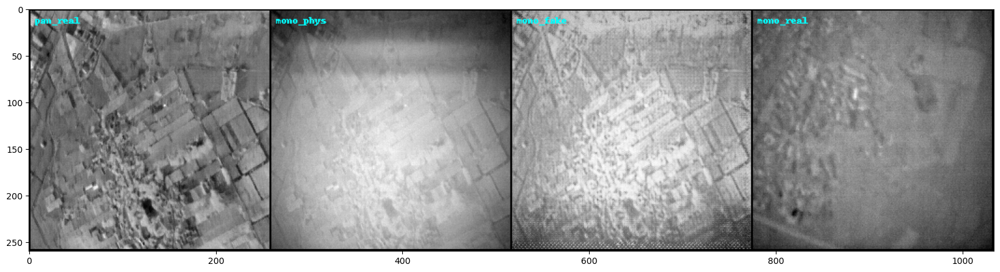

Epoch 1|100:  53%|█████▎    | 2636/5000 [04:35<03:36, 10.91it/s, Validate]

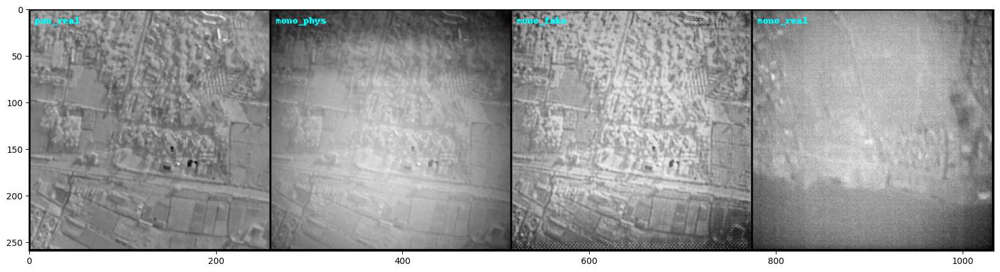

Epoch 1|100: 100%|██████████| 5000/5000 [08:13<00:00, 10.12it/s, Validate]
C:\Users\yakirh\Anaconda3\envs\PETIT_WACV\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\yakirh\Anaconda3\envs\PETIT_WACV\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:18<00:00,  3.93it/s]


Best FID score: 167.39759158367457


Epoch 2|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 2|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

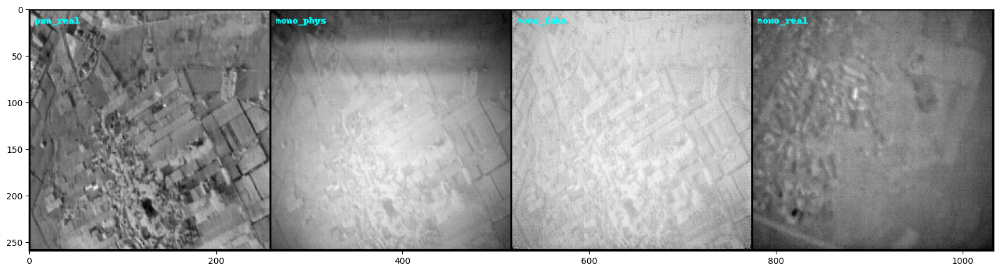

Epoch 2|100:  53%|█████▎    | 2636/5000 [06:32<03:38, 10.84it/s, Validate] 

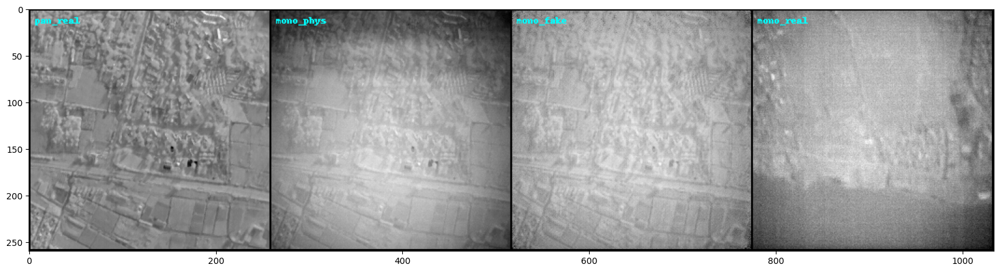

Epoch 2|100: 100%|██████████| 5000/5000 [10:11<00:00,  8.18it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]


Best FID score: 137.74993417171595


Epoch 3|100: 100%|██████████| 500/500 [04:36<00:00,  1.81it/s, Train]
Epoch 3|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

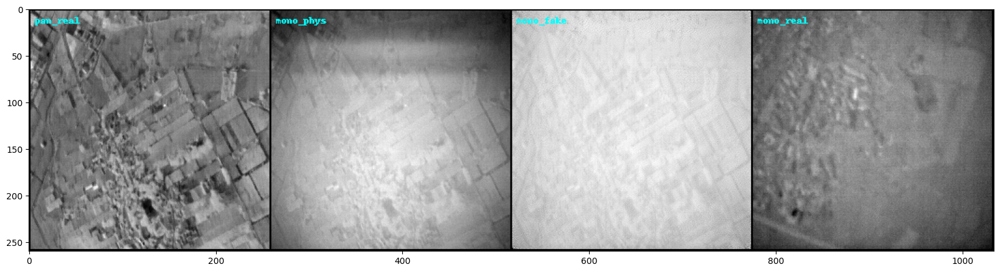

Epoch 3|100:  53%|█████▎    | 2637/5000 [07:00<03:51, 10.21it/s, Validate]

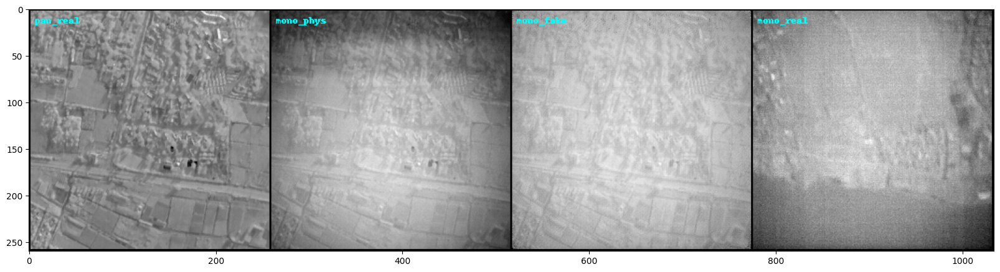

Epoch 3|100: 100%|██████████| 5000/5000 [11:04<00:00,  7.52it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:23<00:00,  3.86it/s]


Best FID score: 129.88625749580385


Epoch 4|100: 100%|██████████| 500/500 [04:44<00:00,  1.76it/s, Train] 
Epoch 4|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

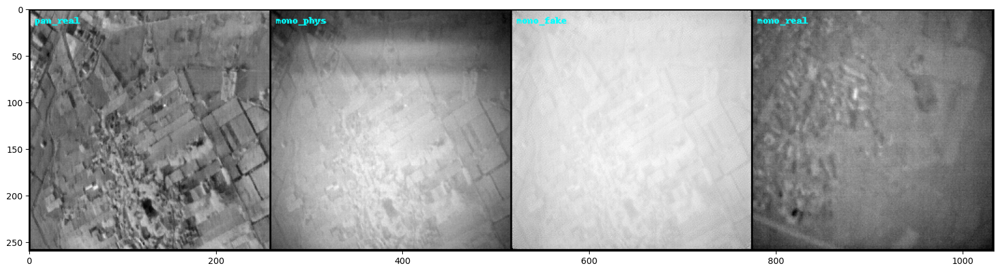

Epoch 4|100:  53%|█████▎    | 2636/5000 [06:47<03:53, 10.10it/s, Validate]

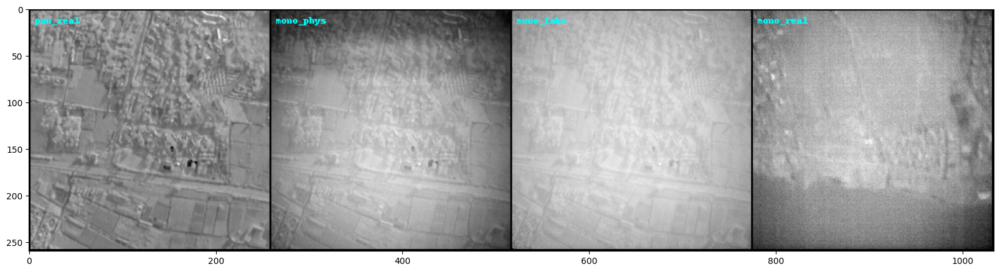

Epoch 4|100: 100%|██████████| 5000/5000 [10:40<00:00,  7.81it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:12<00:00,  3.99it/s]


Best FID score: 112.85998932530265


Epoch 5|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 5|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

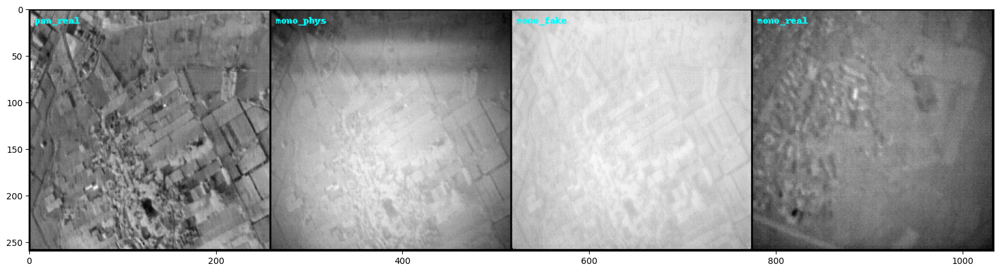

Epoch 5|100:  53%|█████▎    | 2636/5000 [06:28<03:36, 10.93it/s, Validate] 

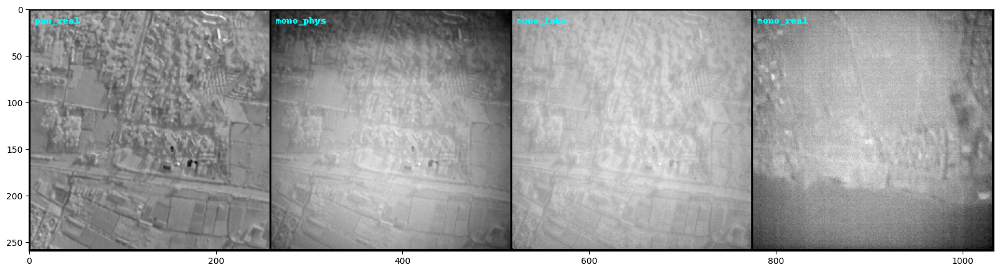

Epoch 5|100: 100%|██████████| 5000/5000 [10:06<00:00,  8.25it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.02it/s]
Epoch 6|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 6|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

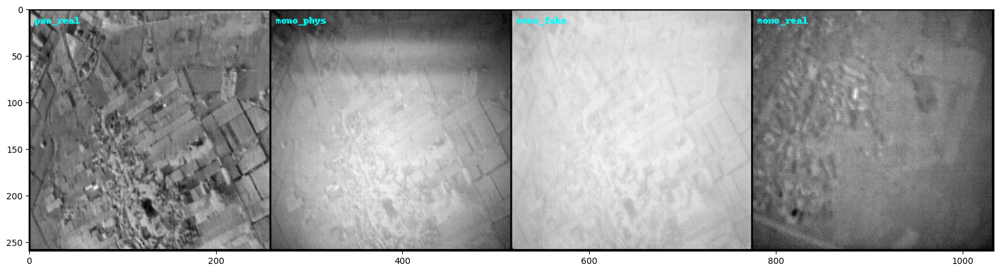

Epoch 6|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.90it/s, Validate] 

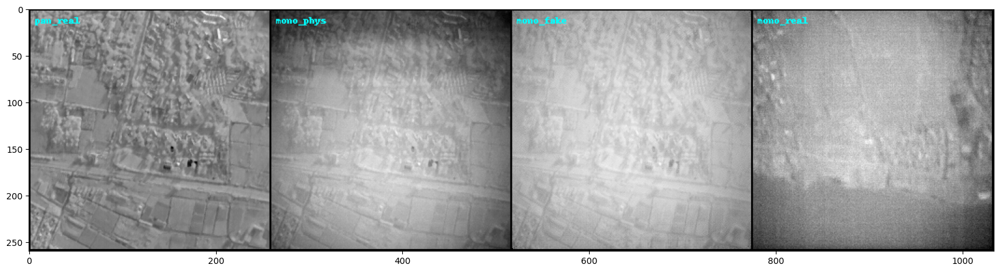

Epoch 6|100: 100%|██████████| 5000/5000 [10:09<00:00,  8.20it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.02it/s]
Epoch 7|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 7|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

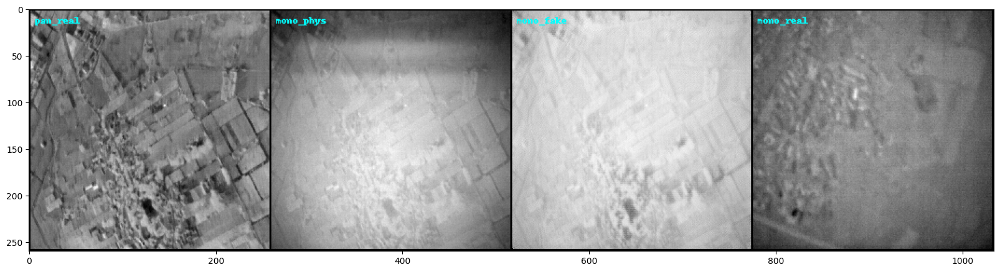

Epoch 7|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.90it/s, Validate] 

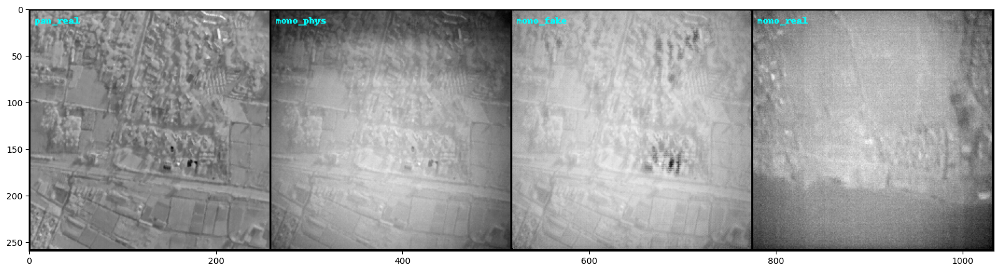

Epoch 7|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]
Epoch 8|100: 100%|██████████| 500/500 [04:31<00:00,  1.84it/s, Train]
Epoch 8|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

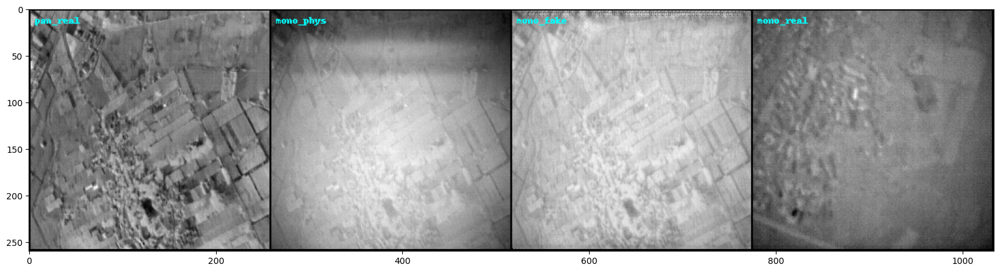

Epoch 8|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.93it/s, Validate] 

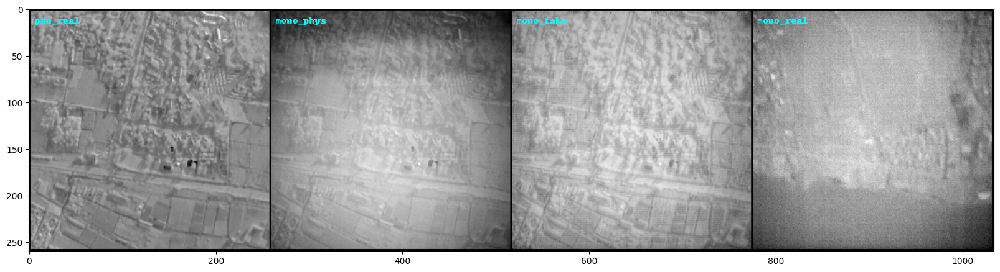

Epoch 8|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.22it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]
Epoch 9|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 9|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

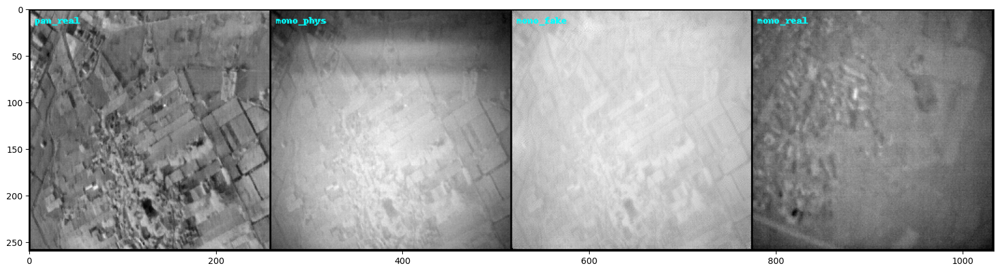

Epoch 9|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.92it/s, Validate] 

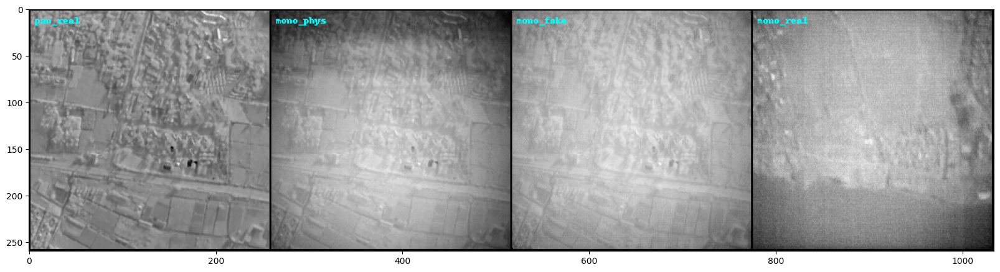

Epoch 9|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.22it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.02it/s]


Best FID score: 108.22603058614717


Epoch 10|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 10|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

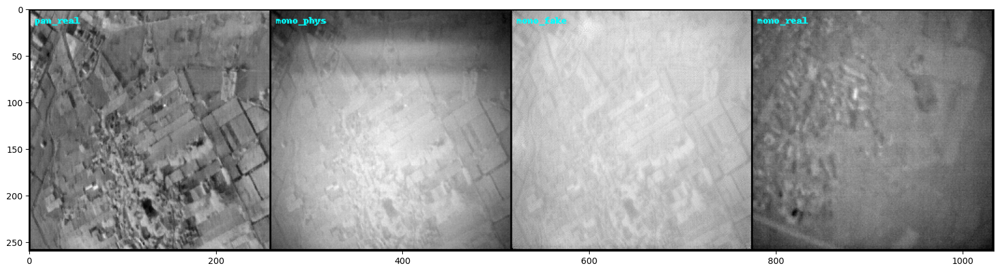

Epoch 10|100:  53%|█████▎    | 2637/5000 [06:29<03:36, 10.91it/s, Validate]

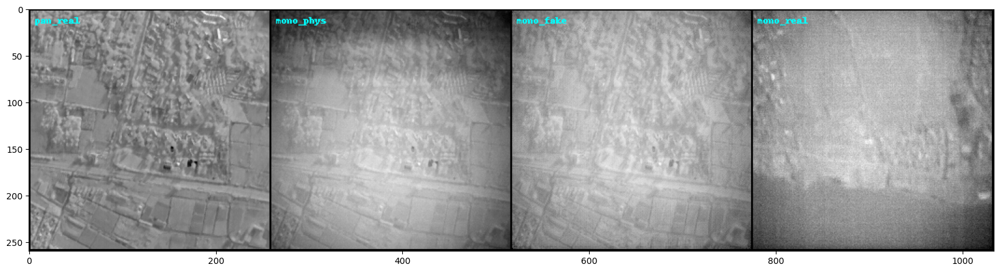

Epoch 10|100: 100%|██████████| 5000/5000 [10:11<00:00,  8.18it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:13<00:00,  3.99it/s]
Epoch 11|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 11|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

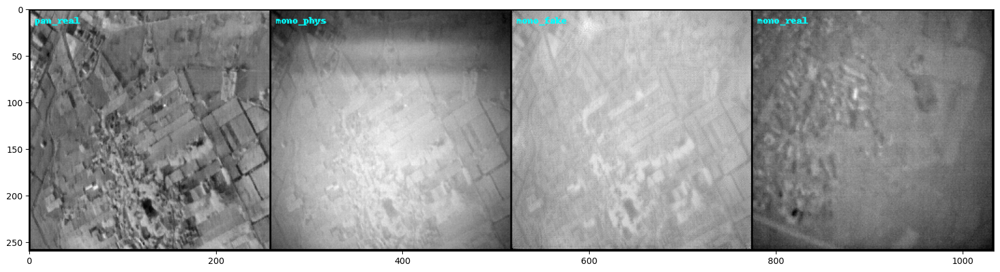

Epoch 11|100:  53%|█████▎    | 2636/5000 [06:28<03:36, 10.93it/s, Validate] 

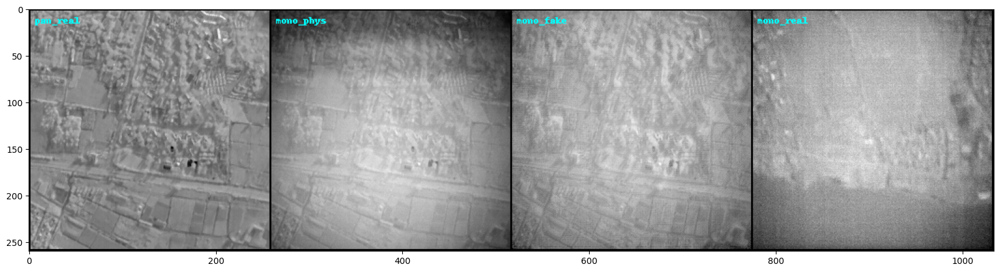

Epoch 11|100: 100%|██████████| 5000/5000 [10:06<00:00,  8.24it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:10<00:00,  4.02it/s]


Best FID score: 107.39412468866612


Epoch 12|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 12|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

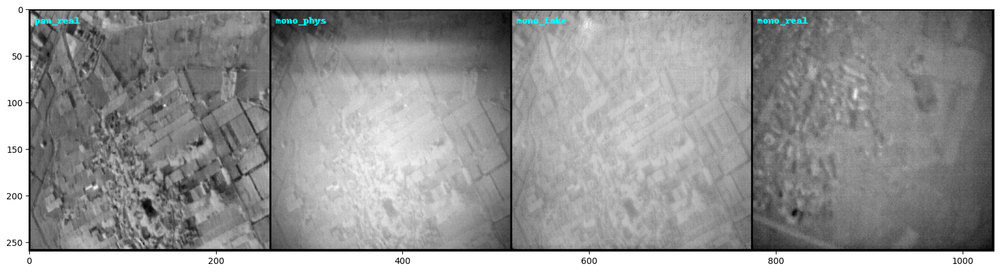

Epoch 12|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.90it/s, Validate] 

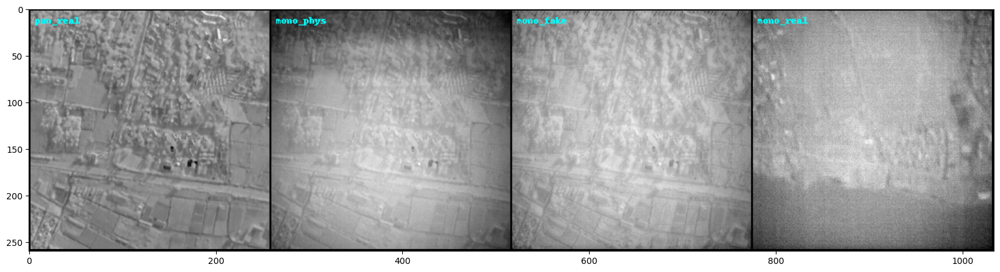

Epoch 12|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.22it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]
Epoch 13|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 13|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

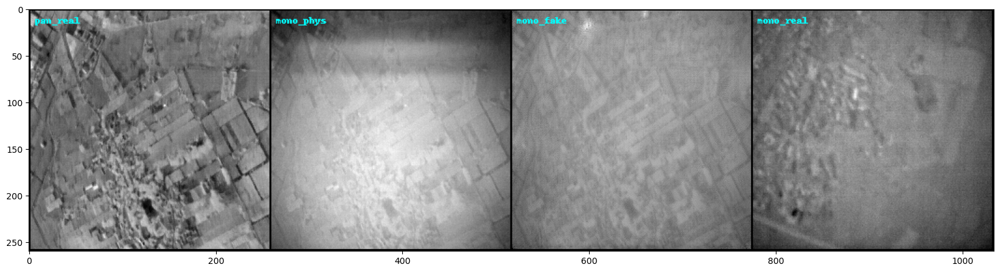

Epoch 13|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.94it/s, Validate] 

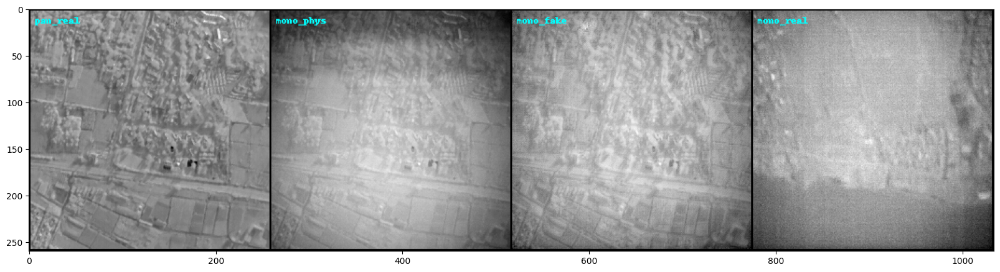

Epoch 13|100: 100%|██████████| 5000/5000 [10:09<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]
Epoch 14|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 14|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

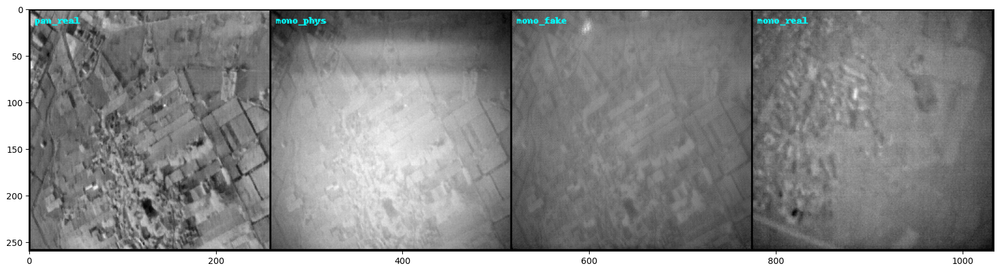

Epoch 14|100:  53%|█████▎    | 2637/5000 [06:31<03:37, 10.88it/s, Validate]

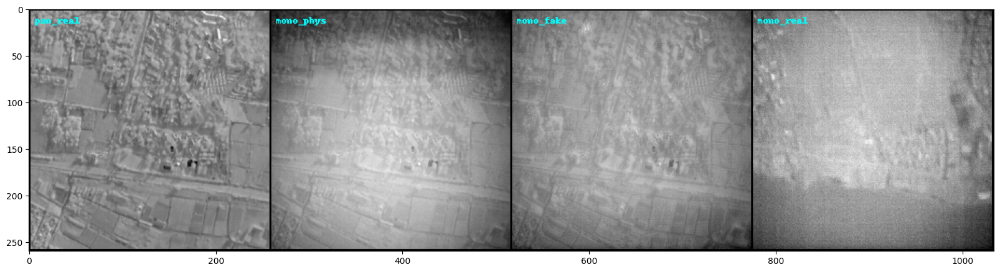

Epoch 14|100: 100%|██████████| 5000/5000 [10:10<00:00,  8.19it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]


Best FID score: 89.20192717468808


Epoch 15|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 15|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

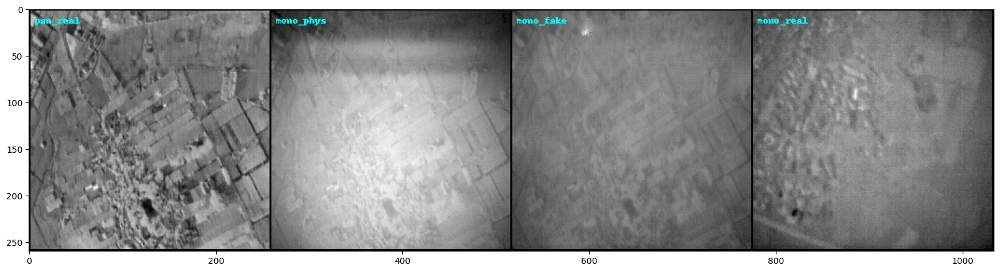

Epoch 15|100:  53%|█████▎    | 2637/5000 [06:30<03:37, 10.85it/s, Validate]

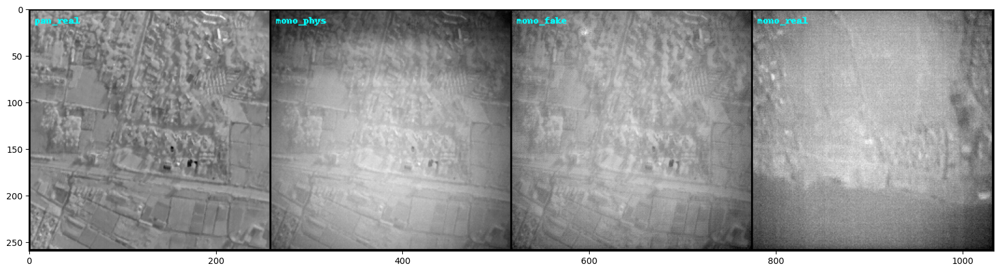

Epoch 15|100: 100%|██████████| 5000/5000 [10:09<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:12<00:00,  4.00it/s]
Epoch 16|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 16|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

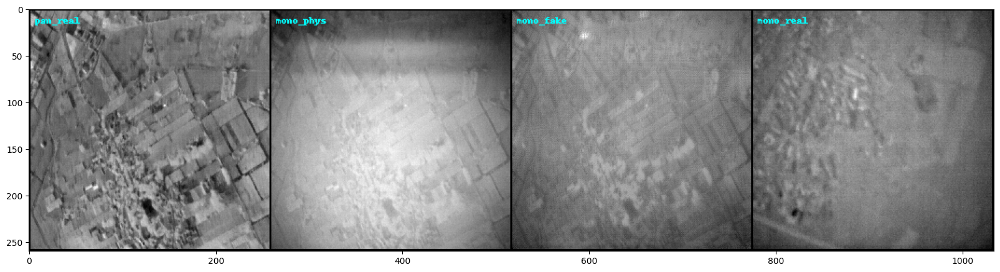

Epoch 16|100:  53%|█████▎    | 2636/5000 [06:30<03:36, 10.92it/s, Validate] 

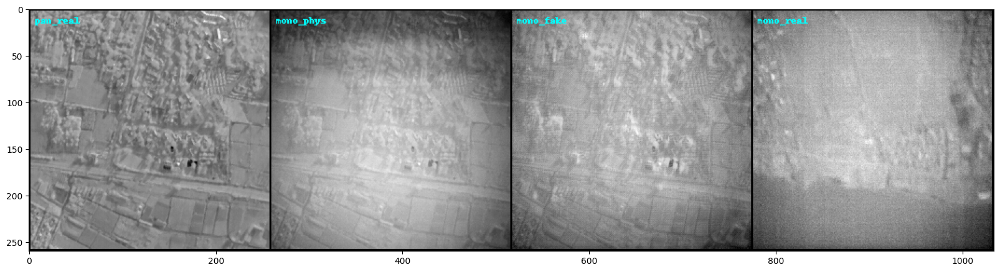

Epoch 16|100: 100%|██████████| 5000/5000 [10:09<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:12<00:00,  4.00it/s]


Best FID score: 84.66874176964063


Epoch 17|100: 100%|██████████| 500/500 [04:31<00:00,  1.84it/s, Train]
Epoch 17|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

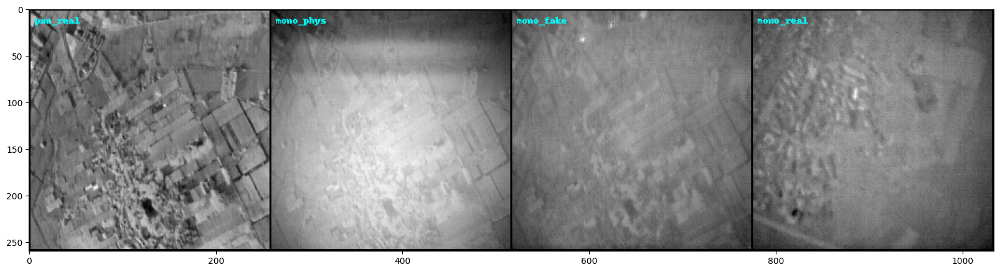

Epoch 17|100:  53%|█████▎    | 2636/5000 [06:30<03:37, 10.89it/s, Validate] 

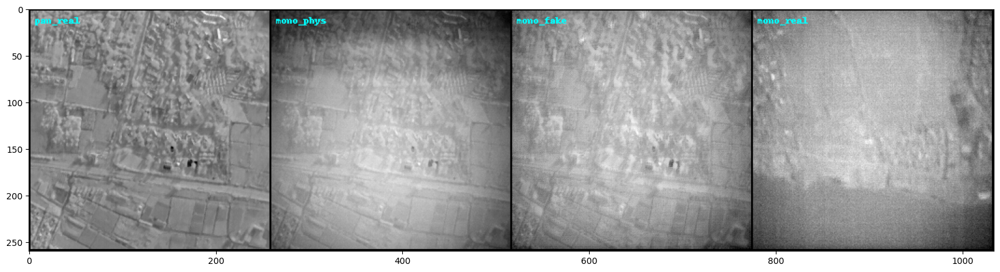

Epoch 17|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:12<00:00,  4.00it/s]


Best FID score: 83.03782802980044


Epoch 18|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 18|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

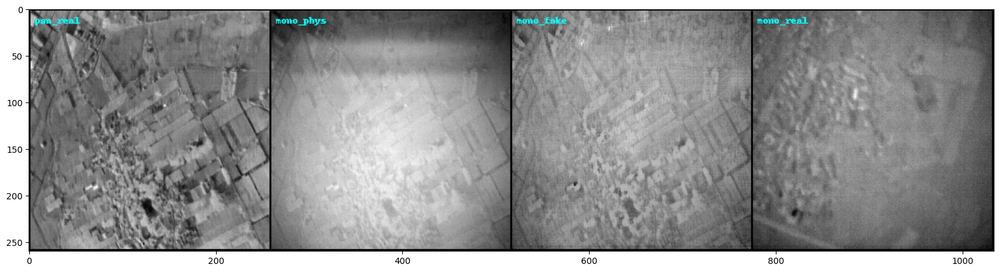

Epoch 18|100:  53%|█████▎    | 2636/5000 [06:30<03:39, 10.78it/s, Validate] 

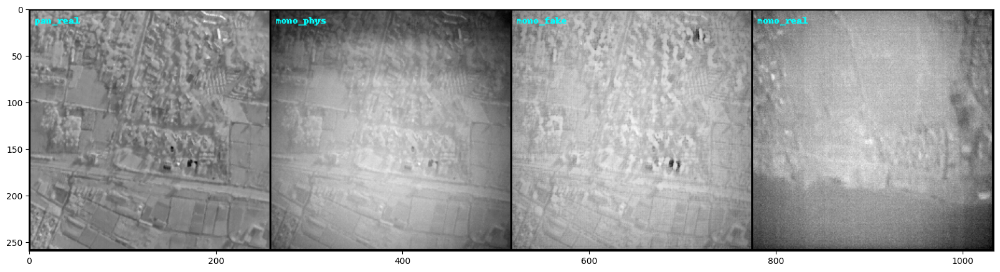

Epoch 18|100: 100%|██████████| 5000/5000 [10:09<00:00,  8.20it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:47<00:00,  3.59it/s]
Epoch 19|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 19|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

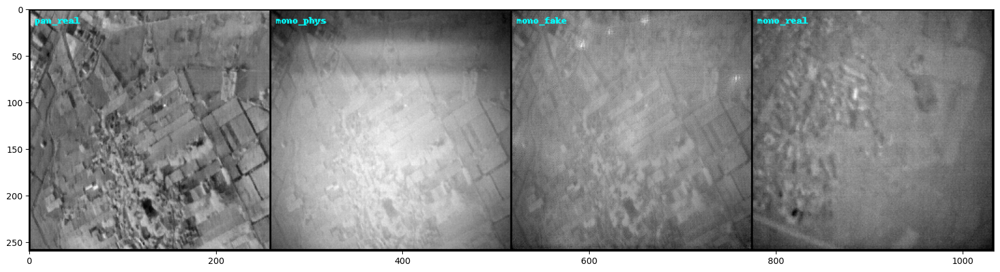

Epoch 19|100:  53%|█████▎    | 2636/5000 [06:30<03:37, 10.88it/s, Validate] 

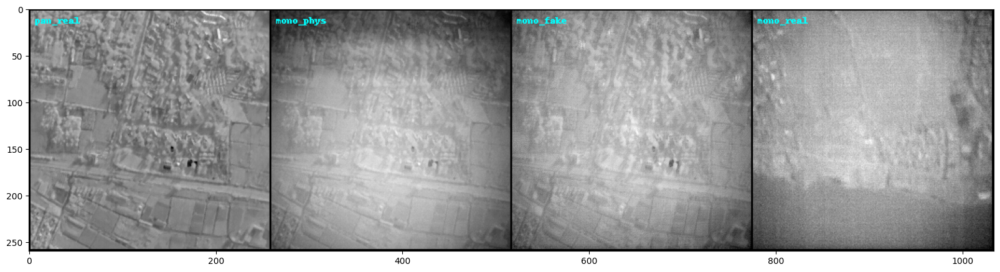

Epoch 19|100: 100%|██████████| 5000/5000 [10:08<00:00,  8.21it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [05:11<00:00,  4.01it/s]


Best FID score: 78.66386249896692


Epoch 20|100: 100%|██████████| 500/500 [04:30<00:00,  1.85it/s, Train]
Epoch 20|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

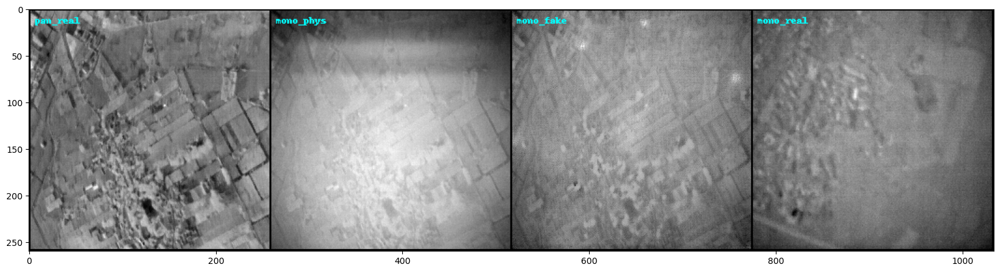

Epoch 20|100:  53%|█████▎    | 2637/5000 [06:31<03:36, 10.93it/s, Validate]

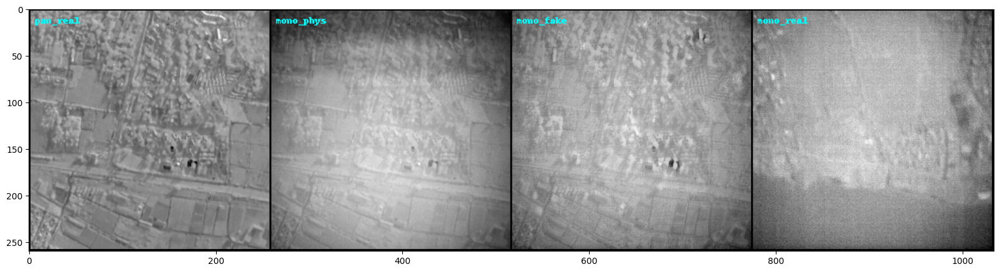

Epoch 20|100: 100%|██████████| 5000/5000 [10:11<00:00,  8.18it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:28<00:00,  5.99it/s]
Epoch 21|100: 100%|██████████| 500/500 [02:47<00:00,  2.99it/s, Train]
Epoch 21|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

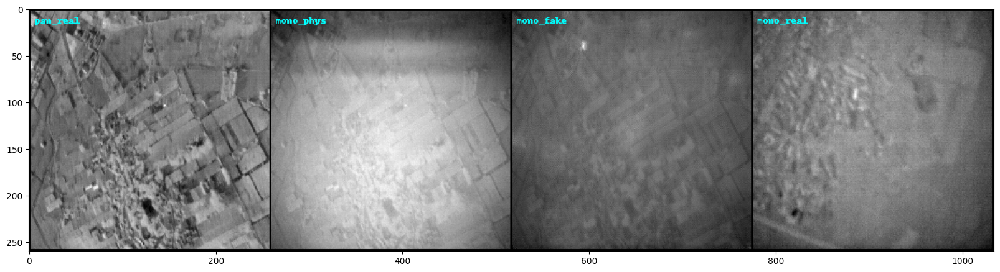

Epoch 21|100:  53%|█████▎    | 2637/5000 [04:48<03:37, 10.87it/s, Validate]

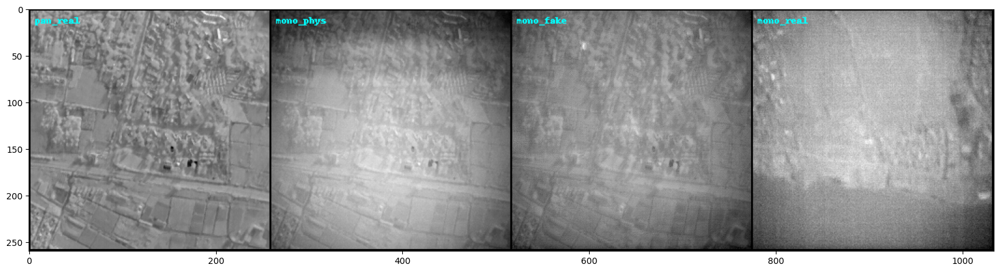

Epoch 21|100: 100%|██████████| 5000/5000 [08:28<00:00,  9.83it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:28<00:00,  6.00it/s]


Best FID score: 73.40805946342459


Epoch 22|100: 100%|██████████| 500/500 [02:47<00:00,  2.98it/s, Train]
Epoch 22|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

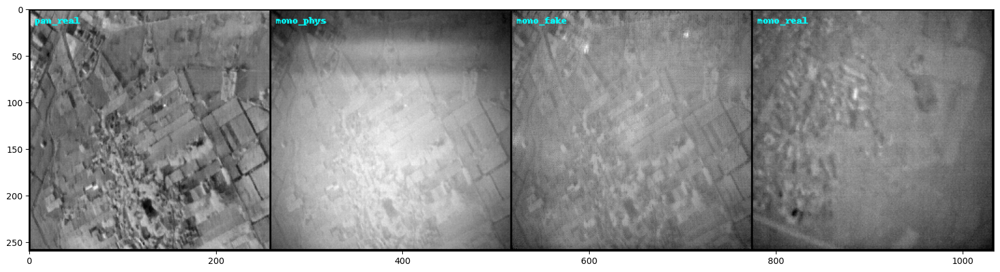

Epoch 22|100:  53%|█████▎    | 2637/5000 [04:47<03:38, 10.82it/s, Validate]

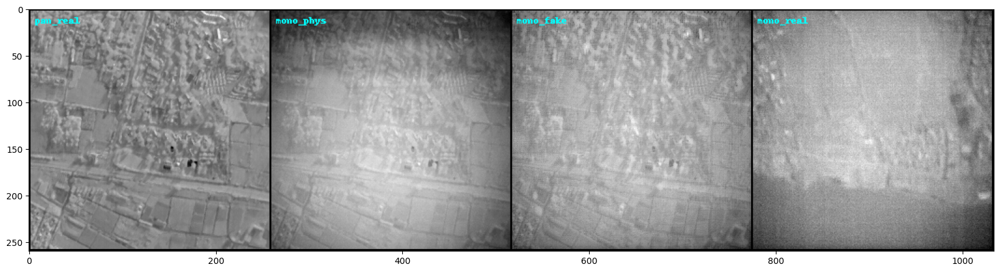

Epoch 22|100: 100%|██████████| 5000/5000 [08:26<00:00,  9.87it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:27<00:00,  6.03it/s]
Epoch 23|100: 100%|██████████| 500/500 [02:46<00:00,  2.99it/s, Train]
Epoch 23|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

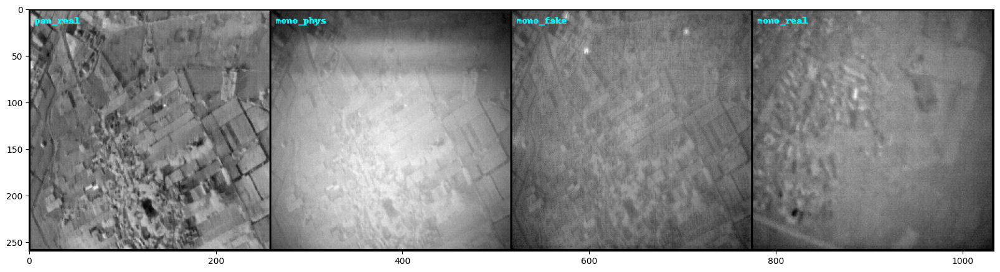

Epoch 23|100:  53%|█████▎    | 2636/5000 [04:49<03:38, 10.84it/s, Validate]

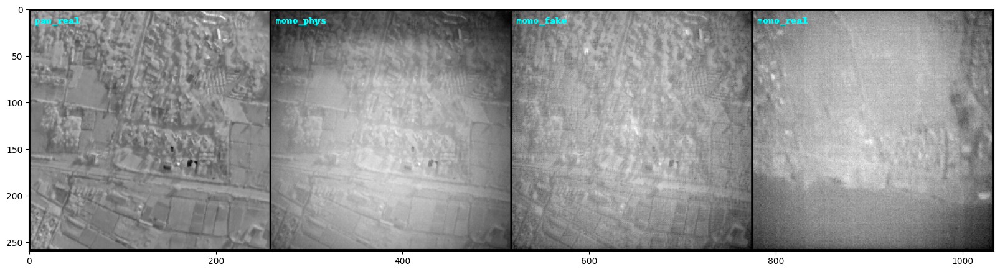

Epoch 23|100: 100%|██████████| 5000/5000 [08:29<00:00,  9.81it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:27<00:00,  6.02it/s]
Epoch 24|100: 100%|██████████| 500/500 [02:31<00:00,  3.31it/s, Train]
Epoch 24|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

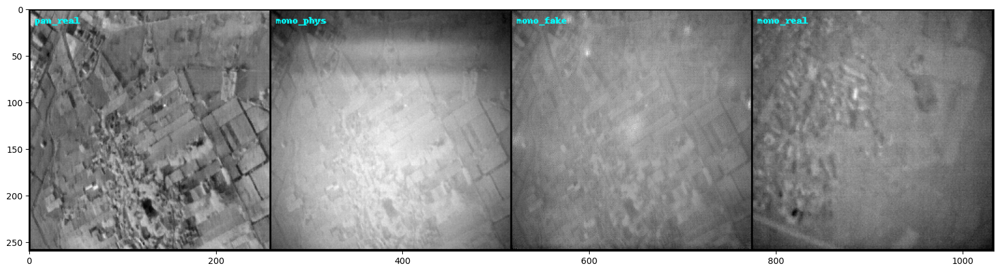

Epoch 24|100:  53%|█████▎    | 2637/5000 [07:02<03:37, 10.88it/s, Validate] 

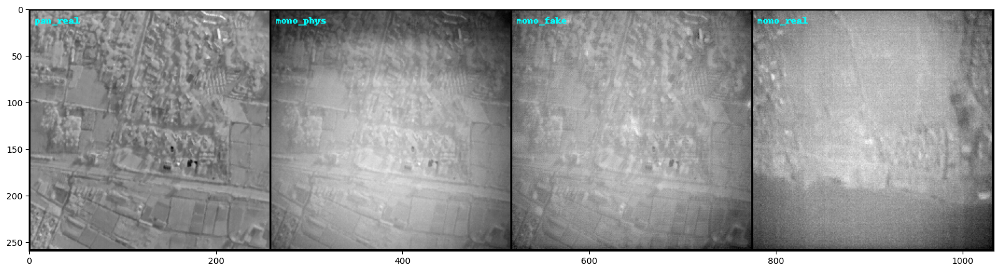

Epoch 24|100: 100%|██████████| 5000/5000 [10:41<00:00,  7.80it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:27<00:00,  6.01it/s]


Best FID score: 64.49123409714664


Epoch 25|100: 100%|██████████| 500/500 [02:46<00:00,  3.00it/s, Train]
Epoch 25|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

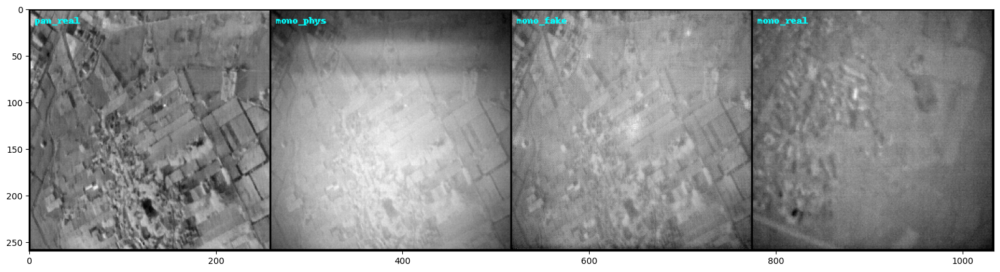

Epoch 25|100:  53%|█████▎    | 2636/5000 [04:46<03:36, 10.92it/s, Validate]

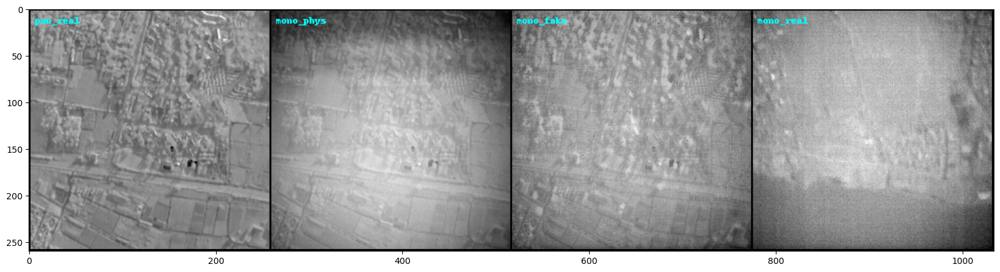

Epoch 25|100: 100%|██████████| 5000/5000 [08:25<00:00,  9.89it/s, Validate]


11000nm dataset was created


test checkpoint: 100%|██████████| 1250/1250 [03:28<00:00,  5.99it/s]
Epoch 26|100: 100%|██████████| 500/500 [02:46<00:00,  3.00it/s, Train]
Epoch 26|100:   0%|          | 0/5000 [00:00<?, ?it/s, Validate]

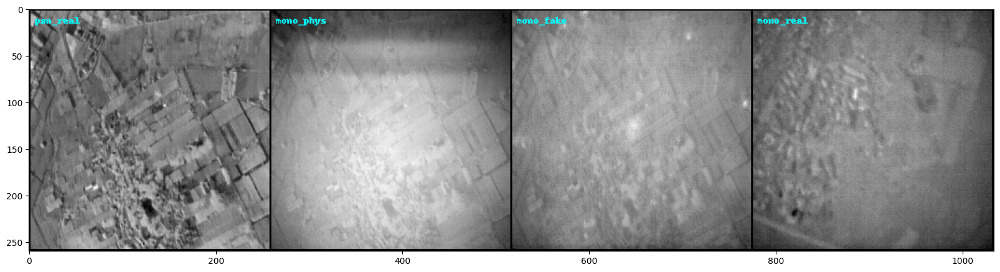

Epoch 26|100:  53%|█████▎    | 2637/5000 [04:47<03:38, 10.82it/s, Validate]

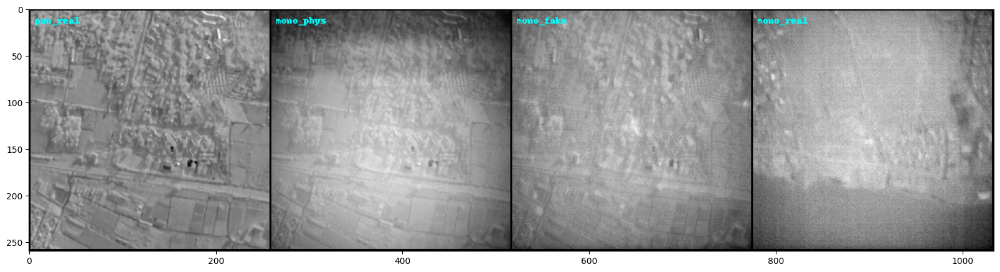

Epoch 26|100:  81%|████████▏ | 4066/5000 [06:59<01:27, 10.64it/s, Validate]

In [ ]:
# TODO: update order of visualized images (mono_phys before mono_fake)
path_to_save = Path.cwd() / 'results' / 'train' / datetime.now().strftime('%d_%m_%y__%H_%M')
path_to_save.mkdir(parents=True, exist_ok=True)

tot_epochs = config.scheduler.n_epochs + config.scheduler.n_epochs_decay + 1
best_fid_score = np.inf  # initialize fid threshold for best solution saving
rand_val_idx = np.random.randint(low=0, high=len(val_loader))  # used to randomly pick image for saving
for epoch in range(1, tot_epochs):
    # Train
    model.set_phase(NetPhase.train)
    for i, data in enumerate(tqdm(train_loader, postfix="Train", desc=f"Epoch {epoch}|{tot_epochs-1}")):
        if epoch == 1 and i == 0 and 'cut' in str(model.__class__).lower():  # first iteration:
            model.data_dependent_initialize(data)
        model.set_input(data)
        model.forward()

        if config.network.gan_mode == "wgangp" and i % config.network.n_critic:
            train_gen = False
        else:
            train_gen = True
        model.optimize_parameters(train_gen)
    model.update_loss(epoch, len(train_loader))

    # Validate
    model.set_phase(NetPhase.val)
    with torch.inference_mode():
        for i, data in enumerate(tqdm(val_loader, postfix="Validate", desc=f"Epoch {epoch}|{tot_epochs-1}")):
            model.set_input(data)
            model.forward()

            # additionally calculate losses for visualization purposes:
            model.calc_loss_D()
            model.calc_loss_G()
            model.update_agg_loss()

            # track visual performance:
            if i in [0, rand_val_idx]:
                plt.figure(figsize=(20, 10))
                plt.imshow(model.gen_vis_grid().permute(1, 2, 0))
                plt.show()
                plt.close()

    model.update_loss(epoch, len(val_loader))
    model.update_learning_rate()  # update learning rates in the beginning of every epoch.

    # calculate FID. TODO: remove after asserting the correlation with loss components
    fid_score = get_fid_score(config, model, batch_size=cpu_count())
    if fid_score < best_fid_score:
        model.save_networks("best", path_to_save / "checkpoints")
        best_fid_score = fid_score
        print(f'Best FID score: {best_fid_score}')

model.save_networks("last", path_to_save / "checkpoints")